In [1]:
import numpy as np
from scipy.integrate import solve_ivp
import matplotlib.pyplot as plt

/var/folders/1k/rdwyb7sd6hq23xhhtb7j4y100000gq/T/ipykernel_8361/2053582408.py:22: RuntimeWarning: invalid value encountered in scalar power
  d_velocity = (-G*radius**(100/57 - 2) - (K*gamma*(rho(self,radius))**(3)))/radius


0.0 nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan
nan nan


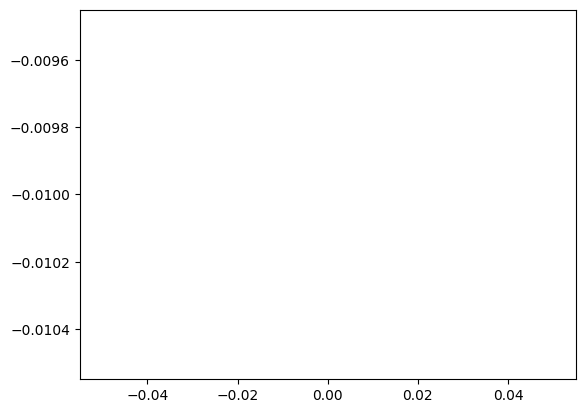

In [30]:
G = 6.67e-11
rho0 = 1e5
Msun = 1e30
Rsun = 7e8
K = 3.14e12
gamma = 5/3




class Star(object):
    def __init__(self,M,R):
        self.M = M
        self.R = R

    def __call__(self,init,t):
        def rho(self,r):
            return(rho0 * (1 - (r/self.R)**2))
        radius = init[0]
        velocity = init[1]
        d_radius = velocity
        d_velocity = (-G*radius**(100/57 - 2) - (K*gamma*(rho(self,radius))**(3)))/radius
        print(d_radius,d_velocity)
        return np.array([d_radius, d_velocity], float)

    
star = Star(Msun,Rsun)

tstart = 0
tstop = 200000
N = 500000
h = (tstop-tstart)/N

xpnt = []
ypnt = []
t = np.linspace(tstart,tstop,N)
init = np.array([Rsun-Rsun*1.01,0],float)

for i in t:
    xpnt.append(init[0])
    ypnt.append(init[1])
    k1 = h*star(init,i)
    k2 = h*star(init + 0.5*k1, i + 0.5*h)
    k3 = h*star(init + 0.5*k2, i + 0.5*h)
    k4 = h*star(init + k3, i + h)
    init += (1/6) * (k1 + 2*k2 + 2*k3 + k4)

plt.plot((t),np.array(xpnt)/(Rsun))


(0.0, 10.0)

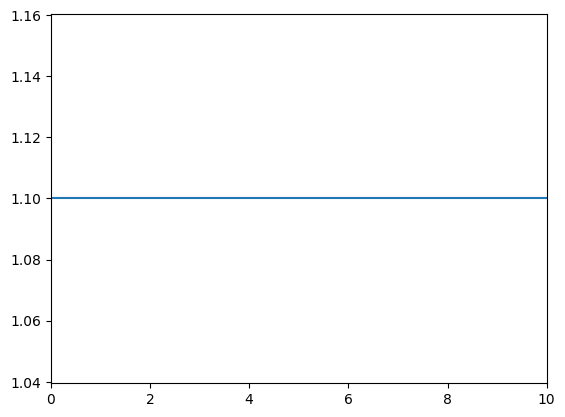

In [21]:
plt.plot((t),np.array(xpnt)/(Rsun))
plt.xlim(0,10)